In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/playground-series-s5e10/sample_submission.csv
/kaggle/input/playground-series-s5e10/train.csv
/kaggle/input/playground-series-s5e10/test.csv


# **0. Imports**

In [2]:
import os, gc, warnings, numpy as np, pandas as pd
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error

import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostRegressor

# CONFIG
SEED = 42
N_FOLDS = 5
USE_GPU = True
INPUT_DIR = '/kaggle/input/playground-series-s5e10'
TRAIN_PATH = f'{INPUT_DIR}/train.csv'
TEST_PATH  = f'{INPUT_DIR}/test.csv'
TARGET = 'accident_risk'
ID_COL = 'id'

CAT_COLS = [
    'road_type', 'lighting', 'weather', 'time_of_day',
    'road_signs_present', 'public_road', 'holiday', 'school_season'
]

np.random.seed(SEED)
sns.set_style("whitegrid")

# **1. Enhanced EDA**

In [3]:
print("Loading data for EDA...")
train = pd.read_csv(TRAIN_PATH)
test  = pd.read_csv(TEST_PATH)
print(f"Train shape: {train.shape} | Test shape: {test.shape}")

Loading data for EDA...
Train shape: (517754, 14) | Test shape: (172585, 13)


## **1.1. Correlation heatmap (numeric only)**

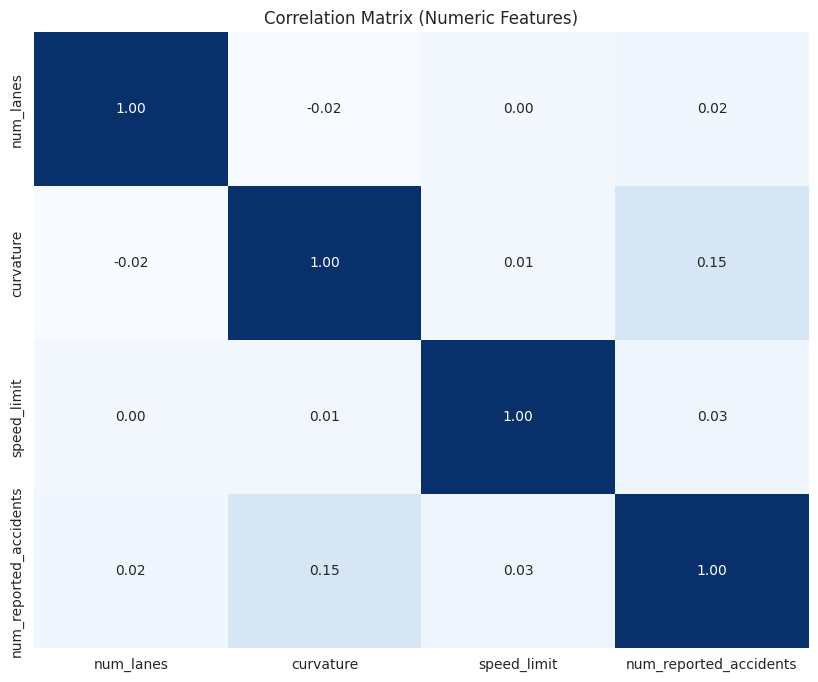

In [4]:
num_cols = train.select_dtypes(include=np.number).columns.drop([TARGET, ID_COL])
corr = train[num_cols].corr()
plt.figure(figsize=(10,8))
sns.heatmap(corr, annot=True, fmt='.2f', cmap='Blues', cbar=False)
plt.title("Correlation Matrix (Numeric Features)")
plt.show()

## **1.2. Categorical value counts**

In [5]:
for col in CAT_COLS[:4]:
    fig = px.bar(
        train[col].value_counts().reset_index(),
        x=col, y='count', title=f'Count of {col}',
        color_discrete_sequence=['#1e3a5f']
    )
    fig.show()

## **1.3. PCA 2D projection**

In [6]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
pca_data = scaler.fit_transform(train[num_cols].fillna(0))
pca = PCA(n_components=2)
pca_result = pca.fit_transform(pca_data)

pca_df = pd.DataFrame(pca_result, columns=['PC1','PC2'])
pca_df[TARGET] = train[TARGET].values

fig = px.scatter(
    pca_df, x='PC1', y='PC2', color=TARGET,
    title='PCA Projection (2D) - Colored by Target',
    color_continuous_scale='Viridis', opacity=0.7
)
fig.update_layout(height=600)
fig.show()

print(f"PCA Explained Variance: {pca.explained_variance_ratio_.sum():.3f}")

PCA Explained Variance: 0.539


# **2. Feature Engineering**

<div style="background:#fff; padding:22px; border:2px solid #1e3a5f; border-radius:12px; margin-bottom:20px; box-shadow:0 4px 12px rgba(0,0,0,0.1);">
  <h4 style="color:#1e3a5f; margin-top:0; border-bottom:1px solid #1e3a5f; padding-bottom:8px;">create_features(df)</h4>
  <p style="font-size:15px; line-height:1.6; color:#2c3e50;">
    Generates high‑impact, physics‑inspired, and statistically meaningful features.<br>
    Includes speed‑curvature interactions, lane‑adjusted metrics, cyclic time encoding, and binary risk flags.<br>
    Adds targeted group‑by statistics (mean & difference) for <code>road_type</code> and <code>weather</code>.<br>
    Fills missing values with 0 to ensure robustness across train/test splits.
  </p>
</div>

In [7]:
def create_features(df):
    out = df.copy()
    
    # Physics‑based interactions
    out['speed_x_curve']   = out['speed_limit'] * out['curvature']
    out['speed_per_lane']  = out['speed_limit'] / (out['num_lanes'] + 1)
    out['kinetic_risk']    = out['speed_limit']**2 * out['curvature']
    
    # Cyclic time encoding
    hour_map = {'morning':8, 'afternoon':14, 'evening':19, 'night':1}
    out['hour'] = out['time_of_day'].map(hour_map)
    out['hour_sin'] = np.sin(2*np.pi*out['hour']/24)
    out['hour_cos'] = np.cos(2*np.pi*out['hour']/24)
    out.drop(columns='hour', inplace=True)
    
    # Binary risk flags
    out['night_poor_light'] = ((out['lighting']=='poor') & (out['time_of_day']=='night')).astype(int)
    out['bad_weather']      = (~out['weather'].isin(['clear'])).astype(int)
    
    # Group statistics (only high‑impact)
    for cat in ['road_type', 'weather']:
        for num in ['speed_limit', 'curvature']:
            mean_col = f'{cat}_{num}_mean'
            out[mean_col] = out.groupby(cat)[num].transform('mean')
            out[f'{cat}_{num}_diff'] = out[num] - out[mean_col]
    
    out.fillna(0, inplace=True)
    return out

# **3. Modeling**

<div style="background:#fff; padding:22px; border:2px solid #1e3a5f; border-radius:12px; margin-bottom:20px; box-shadow:0 4px 12px rgba(0,0,0,0.1);">
  <h4 style="color:#1e3a5f; margin-top:0; border-bottom:1px solid #1e3a5f; padding-bottom:8px;">label_encode(train, test)</h4>
  <p style="font-size:15px; line-height:1.6; color:#2c3e50;">
    Applies consistent <code>LabelEncoder</code> to all categorical columns in <code>CAT_COLS</code>.<br>
    Fits on the <strong>combined train+test</strong> data to prevent unseen categories in test.<br>
    Ensures tree‑based models (LGBM, XGBoost, CatBoost) receive integer‑encoded inputs.<br>
    Returns updated DataFrames ready for modeling.
  </p>
</div>

In [8]:
def label_encode(train, test):
    for col in CAT_COLS:
        le = LabelEncoder()
        combined = pd.concat([train[col], test[col]], axis=0).astype(str)
        le.fit(combined)
        train[col] = le.transform(train[col].astype(str))
        test[col]  = le.transform(test[col].astype(str))
    return train, test

<div style="background:#fff; padding:22px; border:2px solid #1e3a5f; border-radius:12px; margin-bottom:20px; box-shadow:0 4px 12px rgba(0,0,0,0.1);">
  <h4 style="color:#1e3a5f; margin-top:0; border-bottom:1px solid #1e3a5f; padding-bottom:8px;">train_lgb(X, y, X_test)</h4>
  <p style="font-size:15px; line-height:1.6; color:#2c3e50;">
    Trains a <strong>LightGBM</strong> regressor using 5‑fold cross‑validation.<br>
    Uses <strong>conservative hyperparameters</strong> (low LR, regularization, small leaves) to prevent overfitting.<br>
    Applies <strong>early stopping (300 rounds)</strong> on validation RMSE.<br>
    Returns OOF predictions, test predictions (averaged), and CV RMSE.
  </p>
</div>

In [9]:
def train_lgb(X, y, X_test):
    params = {
        'objective':'regression','metric':'rmse','learning_rate':0.02,
        'num_leaves':64,'feature_fraction':0.78,'bagging_fraction':0.78,
        'bagging_freq':1,'min_child_samples':45,'reg_alpha':0.6,'reg_lambda':0.6,
        'verbosity':-1,'seed':SEED,'device':'gpu' if USE_GPU else 'cpu'
    }
    kf = KFold(n_splits=N_FOLDS, shuffle=True, random_state=SEED)
    oof = np.zeros(len(X)); pred = np.zeros(len(X_test))

    for fold, (tr, val) in enumerate(kf.split(X), 1):
        tr_x, tr_y = X.iloc[tr], y.iloc[tr]
        val_x, val_y = X.iloc[val], y.iloc[val]

        model = lgb.train(
            params,
            lgb.Dataset(tr_x, tr_y),
            num_boost_round=12000,
            valid_sets=[lgb.Dataset(val_x, val_y)],
            callbacks=[lgb.early_stopping(300), lgb.log_evaluation(0)]
        )
        oof[val] = model.predict(val_x)
        pred += model.predict(X_test) / N_FOLDS

    rmse = mean_squared_error(y, oof, squared=False)
    print(f'   LGBM  CV RMSE: {rmse:.6f}')
    return oof, pred, rmse

<div style="background:#fff; padding:22px; border:2px solid #1e3a5f; border-radius:12px; margin-bottom:20px; box-shadow:0 4px 12px rgba(0,0,0,0.1);">
  <h4 style="color:#1e3a5f; margin-top:0; border-bottom:1px solid #1e3a5f; padding-bottom:8px;">train_xgb(X, y, X_test)</h4>
  <p style="font-size:15px; line-height:1.6; color:#2c3e50;">
    Trains an <strong>XGBoost</strong> model with GPU‑accelerated histogram method.<br>
    Employs <strong>shallow trees (depth=7)</strong> and strong L1/L2 regularization.<br>
    Uses <strong>early stopping (300 rounds)</strong> based on validation loss.<br>
    Returns OOF predictions, averaged test predictions, and final CV RMSE.
  </p>
</div>

In [10]:
def train_xgb(X, y, X_test):
    params = {
        'objective':'reg:squarederror','max_depth':7,'learning_rate':0.02,
        'subsample':0.78,'colsample_bytree':0.78,'lambda':1.0,'alpha':1.0,
        'random_state':SEED,'tree_method':'gpu_hist' if USE_GPU else 'hist'
    }
    kf = KFold(n_splits=N_FOLDS, shuffle=True, random_state=SEED)
    oof = np.zeros(len(X)); pred = np.zeros(len(X_test))

    for tr, val in kf.split(X):
        dtr = xgb.DMatrix(X.iloc[tr], y.iloc[tr])
        dval = xgb.DMatrix(X.iloc[val], y.iloc[val])
        dtest = xgb.DMatrix(X_test)

        model = xgb.train(
            params, dtr, num_boost_round=12000,
            evals=[(dval,'val')], early_stopping_rounds=300,
            verbose_eval=False
        )
        best_it = model.best_iteration
        oof[val] = model.predict(dval, iteration_range=(0, best_it))
        pred += model.predict(dtest, iteration_range=(0, best_it)) / N_FOLDS

    rmse = mean_squared_error(y, oof, squared=False)
    print(f'   XGBoost CV RMSE: {rmse:.6f}')
    return oof, pred, rmse

<div style="background:#fff; padding:22px; border:2px solid #1e3a5f; border-radius:12px; margin-bottom:20px; box-shadow:0 4px 12px rgba(0,0,0,0.1);">
  <h4 style="color:#1e3a5f; margin-top:0; border-bottom:1px solid #1e3a5f; padding-bottom:8px;">train_cat(X, y, X_test)</h4>
  <p style="font-size:15px; line-height:1.6; color:#2c3e50;">
    Trains a <strong>CatBoost</strong> regressor with native categorical feature support.<br>
    Uses <strong>depth=7</strong>, <code>l2_leaf_reg=6</code>, and low learning rate for stability.<br>
    Applies <strong>early stopping (300 rounds)</strong> on validation set.<br>
    Returns OOF and averaged test predictions along with CV RMSE.
  </p>
</div>

In [11]:
def train_cat(X, y, X_test):
    cat_idx = [X.columns.get_loc(c) for c in CAT_COLS if c in X.columns]
    kf = KFold(n_splits=N_FOLDS, shuffle=True, random_state=SEED)
    oof = np.zeros(len(X)); pred = np.zeros(len(X_test))

    for tr, val in kf.split(X):
        model = CatBoostRegressor(
            iterations=12000, learning_rate=0.02, depth=7,
            l2_leaf_reg=6, random_state=SEED,
            task_type='GPU' if USE_GPU else 'CPU',
            early_stopping_rounds=300, verbose=False
        )
        model.fit(
            X.iloc[tr], y.iloc[tr],
            eval_set=(X.iloc[val], y.iloc[val]),
            cat_features=cat_idx, verbose=False
        )
        oof[val] = model.predict(X.iloc[val])
        pred += model.predict(X_test) / N_FOLDS

    rmse = mean_squared_error(y, oof, squared=False)
    print(f'   CatBoost CV RMSE: {rmse:.6f}')
    return oof, pred, rmse

<div style="background:#fff; padding:22px; border:2px solid #1e3a5f; border-radius:12px; margin-bottom:20px; box-shadow:0 4px 12px rgba(0,0,0,0.1);">
  <h4 style="color:#1e3a5f; margin-top:0; border-bottom:1px solid #1e3a5f; padding-bottom:8px;">weighted_blend(oof_list, pred_list, rmses)</h4>
  <p style="font-size:15px; line-height:1.6; color:#2c3e50;">
    Combines base model predictions using <strong>inverse‑RMSE weighting</strong>.<br>
    Models with lower CV RMSE receive higher weights (more influence).<br>
    Produces final OOF and test predictions via weighted sum.<br>
    Returns blended predictions and the computed weight vector.
  </p>
</div>

In [12]:
def weighted_blend(oof_list, pred_list, rmses):
    inv = 1.0 / np.array(rmses)
    w   = inv / inv.sum()
    final_oof  = sum(o*w for o,w in zip(oof_list, w))
    final_pred = sum(p*w for p,w in zip(pred_list, w))
    return final_oof, final_pred, w

<div style="background:#fff; padding:22px; border:2px solid #1e3a5f; border-radius:12px; margin-bottom:20px; box-shadow:0 4px 12px rgba(0,0,0,0.1);">
  <h4 style="color:#1e3a5f; margin-top:0; border-bottom:1px solid #1e3a5f; padding-bottom:8px;">main()</h4>
  <p style="font-size:15px; line-height:1.6; color:#2c3e50;">
    Orchestrates the full pipeline: data loading, feature engineering, encoding, modeling, blending, and submission.<br>
    Ensures column alignment between train and test.<br>
    Prints CV RMSE for each model and final weighted ensemble.<br>
    Saves clipped predictions to <code>submission.csv</code> and cleans memory.
  </p>
</div>

In [13]:
def main():
    print("Loading data...")
    train = pd.read_csv(TRAIN_PATH)
    test  = pd.read_csv(TEST_PATH)

    y = train[TARGET].copy()
    test_ids = test[ID_COL].copy()

    train.drop(columns=[TARGET, ID_COL], inplace=True)
    test.drop(columns=[ID_COL], inplace=True)

    # ---- features ------------------------------------------------
    print("Engineering features...")
    train = create_features(train)
    test  = create_features(test)

    print("Label‑encoding categoricals...")
    train, test = label_encode(train, test)

    # Align
    test = test.reindex(columns=train.columns, fill_value=0)

    X = train; X_test = test

    # ---- train ---------------------------------------------------
    print("\nTraining base models...")
    oof_l, pred_l, rmse_l = train_lgb(X, y, X_test)
    oof_x, pred_x, rmse_x = train_xgb(X, y, X_test)
    oof_c, pred_c, rmse_c = train_cat(X, y, X_test)

    # ---- ensemble ------------------------------------------------
    print("\nBlending with inverse‑RMSE weights...")
    oof_final, pred_final, weights = weighted_blend(
        [oof_l, oof_x, oof_c],
        [pred_l, pred_x, pred_c],
        [rmse_l, rmse_x, rmse_c]
    )
    print(f'   Weights → LGBM:{weights[0]:.3f}  XGB:{weights[1]:.3f}  CAT:{weights[2]:.3f}')
    final_rmse = mean_squared_error(y, oof_final, squared=False)
    print(f'   FINAL CV RMSE: {final_rmse:.6f}')

    # ---- submission ---------------------------------------------
    sub = pd.DataFrame({ID_COL: test_ids, TARGET: np.clip(pred_final, 0.0, 1.0)})
    sub.to_csv('submission.csv', index=False)
    print('submission.csv saved!')

    # clean up
    del train, test, X, X_test, y
    gc.collect()

In [14]:
if __name__ == '__main__':
    main()

Loading data...
Engineering features...
Label‑encoding categoricals...

Training base models...


1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.
1 warning generated.


Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1160]	valid_0's rmse: 0.0562361
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1167]	valid_0's rmse: 0.0561002
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[889]	valid_0's rmse: 0.0561355
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[889]	valid_0's rmse: 0.0559791
Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1230]	valid_0's rmse: 0.0559448
   LGBM  CV RMSE: 0.056079
   XGBoost CV RMSE: 0.056060
   CatBoost CV RMSE: 0.056132

Blending with inverse‑RMSE weights...
   Weights → LGBM:0.333  XGB:0.334  CAT:0.333
   FINAL CV RMSE: 0.056060
submission.csv saved!


<div style="background:#ffe6e6; padding:26px; border-radius:14px; border:2px solid #ff6b6b; box-shadow:0 6px 16px rgba(0,0,0,0.1); margin:20px 0;">
  <div style="background:#fff; padding:22px; border-radius:12px; font-family:'Segoe UI', sans-serif;">
    <h3 style="color:#d63031; margin-top:0; text-align:center; font-size:1.5em; border-bottom:2px solid #fab1a0; padding-bottom:10px;">
      Thank You for Your Attention!
    </h3>
    <p style="text-align:center; font-size:1.18em; color:#2d3436; margin:18px 0; line-height:1.7;">
      If this notebook was useful, please consider an <strong>upvote</strong> on the competition.
    </p>
    <p style="text-align:center; margin:18px 0;">
      <strong>Connect with me:</strong><br>
      <a href="https://github.com/omid-sakaki-ghazvini" style="color:#d63031; text-decoration:none; font-weight:bold; margin:0 8px;">GitHub</a> • 
      <a href="https://www.linkedin.com/in/omid-sakaki-ghazvini-378687217/" style="color:#d63031; text-decoration:none; font-weight:bold; margin:0 8px;">LinkedIn</a> • 
      <a href="https://omidsakaki.ir/" style="color:#d63031; text-decoration:none; font-weight:bold; margin:0 8px;">Website</a> • 
      <a href="https://huggingface.co/OmidSakaki" style="color:#d63031; text-decoration:none; font-weight:bold; margin:0 8px;">Hugging Face</a>
    </p>
  </div>
</div>